# Homework 2 (100 Points)

The goal of this homework is to get more practice with pandas and get practice with clustering on various datasets.



## Exercise 1 - (50 points)

This exercise will be using the [Airbnb dataset](http://insideairbnb.com/get-the-data.html) for NYC called `listings.csv`. You can download it directly [here](http://data.insideairbnb.com/united-states/ny/new-york-city/2021-11-02/visualisations/listings.csv)

a) Produce a Heatmap using the Folium package (you can install it using pip) of the mean listing price per location (lattitude and longitude) over the NYC map. (5 points)

Hints:
1. generate a base map of NYC to plot over: default_location=[40.693943, -73.985880] 
2. generate an HTML file named `index.html` - open it in your browser and you'll see the heatmap 












In [1]:
import pandas as pd
import numpy as np
import matplotlib
print("Peng Huang U50250882 phuang@bu.edu")
airbnb = pd.read_csv('listings.csv',dtype={'license': object})
# Reference https://stackoverflow.com/questions/24251219/pandas-read-csv-low-memory-and-dtype-options
airbnb.head(10)

Peng Huang U50250882 phuang@bu.edu


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75356,-73.98559,Entire home/apt,150,30,48,2019-11-04,0.33,3,322,0,NaN
1,3831,"Whole flr w/private bdrm, bath & kitchen(pls r...",4869,LisaRoxanne,Brooklyn,Bedford-Stuyvesant,40.68494,-73.95765,Entire home/apt,73,1,408,2021-06-29,4.91,1,220,38,NaN
2,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.68535,-73.95512,Private room,60,30,50,2016-06-05,0.53,2,365,0,NaN
3,5136,"Spacious Brooklyn Duplex, Patio + Garden",7378,Rebecca,Brooklyn,Sunset Park,40.66265,-73.99454,Entire home/apt,275,5,2,2021-08-08,0.02,1,91,1,NaN
4,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Midtown,40.76457,-73.98317,Private room,68,2,505,2021-10-20,3.70,1,218,31,NaN
5,5203,Cozy Clean Guest Room - Family Apt,7490,MaryEllen,Manhattan,Upper West Side,40.80380,-73.96751,Private room,75,2,118,2017-07-12,0.88,1,0,0,NaN
6,5803,"Lovely Room 1, Garden, Best Area, Legal rental",9744,Laurie,Brooklyn,South Slope,40.66801,-73.98784,Private room,98,4,200,2021-11-03,1.46,3,307,19,NaN
7,6848,Only 2 stops to Manhattan studio,15991,Allen & Irina,Brooklyn,Williamsburg,40.70935,-73.95342,Entire home/apt,89,30,181,2021-08-10,1.25,1,197,1,NaN
8,6872,Uptown Sanctuary w/ Private Bath (Month to Month),16104,Kae,Manhattan,East Harlem,40.80107,-73.94255,Private room,65,30,0,NaN,NaN,2,365,0,NaN
9,6990,UES Beautiful Blue Room,16800,Cyn,Manhattan,East Harlem,40.78778,-73.94759,Private room,62,30,234,2021-07-04,1.83,1,314,1,NaN


In [2]:
# https://pandas.pydata.org/docs/user_guide/groupby.html
# df = pd.DataFrame(
#     [
#         ("bird", "Falconiformes", 389.0),
#         ("bird", "Psittaciformes", 24.0),
#         ("mammal", "Carnivora", 80.2),
#         ("mammal", "Primates", np.nan),
#         ("mammal", "Carnivora", 58),
#     ],
#     index=["falcon", "parrot", "lion", "monkey", "leopard"],
#     columns=("class", "order", "max_speed"),
# )
# df

# grouped=df.groupby('class')
# grouped['max_speed'].mean()

from folium.plugins import HeatMap
import folium
grouped = airbnb.groupby(['latitude','longitude'])
grouped.mean() # pandas.core.frame.DataFrame
airbnb_mean_prices=grouped.mean().loc[:,'price'] # pandas.core.series.Series
airbnb_mean_prices

latitude   longitude 
40.504559  -74.249840      98.0
40.521980  -74.180370     145.0
40.523390  -74.205170     118.0
40.531250  -74.201350     650.0
40.531380  -74.191130      89.0
                          ...  
40.910909  -73.894079      70.0
40.911380  -73.896770     120.0
40.911390  -73.903800      37.0
40.911990  -73.849080    1280.0
40.914070  -73.898350      70.0
Name: price, Length: 37165, dtype: float64

In [3]:
'''
References
https://stackoverflow.com/questions/54752175/add-heatmap-to-a-layer-in-folium
https://python-visualization.github.io/folium/plugins.html
'''
import random
coordinates=airbnb_mean_prices.index.tolist()
mean_prices=airbnb_mean_prices.values.tolist()
heat_data=[]
for i in range(len(coordinates)):
    heat_data.append([coordinates[i][0],coordinates[i][1],mean_prices[i]]) # Latitude and Longitude 
    
# heat_data=[[40.504559,-74.249840,98.0],[40.521980 , -74.180370 ,145.0]]
nyc_map = folium.Map([40.693943, -73.985880] , zoom_start=10)
HeatMap(heat_data).add_to(nyc_map)
nyc_map.save("index.html")
nyc_map


b) Normalize the price by subtracting the mean and dividing by the standard deviation. Then reproduce the heatmap from a). Comment on any differences you observe. - (5 points )



In [4]:
airbnb.loc[:,'price'] # pandas.core.series.Series
mean_price=airbnb.loc[:,'price'].mean()
std_price=airbnb.loc[:,'price'].std()

def normalize(price):
    return (price-mean_price)/std_price
    
normalized_prices=airbnb.loc[:,'price'].apply(normalize) # pandas.core.series.Series

airbnb.loc[:,'normalized_price']=normalized_prices
airbnb

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,normalized_price
0,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.753560,-73.985590,Entire home/apt,150,30,48,2019-11-04,0.33,3,322,0,NaN,-0.052751
1,3831,"Whole flr w/private bdrm, bath & kitchen(pls r...",4869,LisaRoxanne,Brooklyn,Bedford-Stuyvesant,40.684940,-73.957650,Entire home/apt,73,1,408,2021-06-29,4.91,1,220,38,NaN,-0.316119
2,5121,BlissArtsSpace!,7356,Garon,Brooklyn,Bedford-Stuyvesant,40.685350,-73.955120,Private room,60,30,50,2016-06-05,0.53,2,365,0,NaN,-0.360584
3,5136,"Spacious Brooklyn Duplex, Patio + Garden",7378,Rebecca,Brooklyn,Sunset Park,40.662650,-73.994540,Entire home/apt,275,5,2,2021-08-08,0.02,1,91,1,NaN,0.374795
4,5178,Large Furnished Room Near B'way,8967,Shunichi,Manhattan,Midtown,40.764570,-73.983170,Private room,68,2,505,2021-10-20,3.70,1,218,31,NaN,-0.333221
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37708,53123149,Lovely Room in Bedford-Stuyvesant Apartment,305240193,June,Brooklyn,Bedford-Stuyvesant,40.682389,-73.955540,Private room,65,30,0,NaN,NaN,391,364,0,NaN,-0.343482
37709,53123691,Unfurnished Room in West Harlem Apartment,305240193,June,Manhattan,Upper West Side,40.801062,-73.961581,Private room,58,30,0,NaN,NaN,391,364,0,NaN,-0.367425
37710,53123840,MASSIVE 8BR/8BTH Brooklyn Townhouse w/ Backyard,13603829,Kay,Brooklyn,Bushwick,40.682358,-73.908384,Entire home/apt,914,1,0,NaN,NaN,7,358,0,NaN,2.560410
37711,53126354,Unfurnished Room in West Harlem Apartment,305240193,June,Manhattan,Upper West Side,40.800454,-73.963746,Private room,66,30,0,NaN,NaN,391,364,0,NaN,-0.340062


In [5]:
grouped_1b = airbnb.groupby(['latitude','longitude'])
grouped_1b.mean() # pandas.core.frame.DataFrame
airbnb_mean_normalized_prices_1b=grouped.mean().loc[:,'normalized_price'] # pandas.core.series.Series

coordinates_1b=airbnb_mean_normalized_prices_1b.index.tolist()
normalized_mean_prices_1b=airbnb_mean_normalized_prices_1b.values.tolist()
normalized_heat_data_1b=[]
for i in range(len(coordinates)):
    normalized_heat_data_1b.append([coordinates_1b[i][0],coordinates_1b[i][1],normalized_mean_prices_1b[i]])
    
# heat_data=[[40.504559,-74.249840,98.0],[40.521980 , -74.180370 ,145.0]]
nyc_map_1b = folium.Map([40.693943, -73.985880] , zoom_start=10)
HeatMap(normalized_heat_data_1b).add_to(nyc_map_1b)
nyc_map_1b.save("index_normalized.html")
nyc_map_1b

KeyError: 'normalized_price'

-> your answer here  
After normalization, some low-price points (like near Newark) can be clearly indicated in the heat map, compared to the un-normalized one from 1(a).

Below is normalized heatmap from 1(b)    
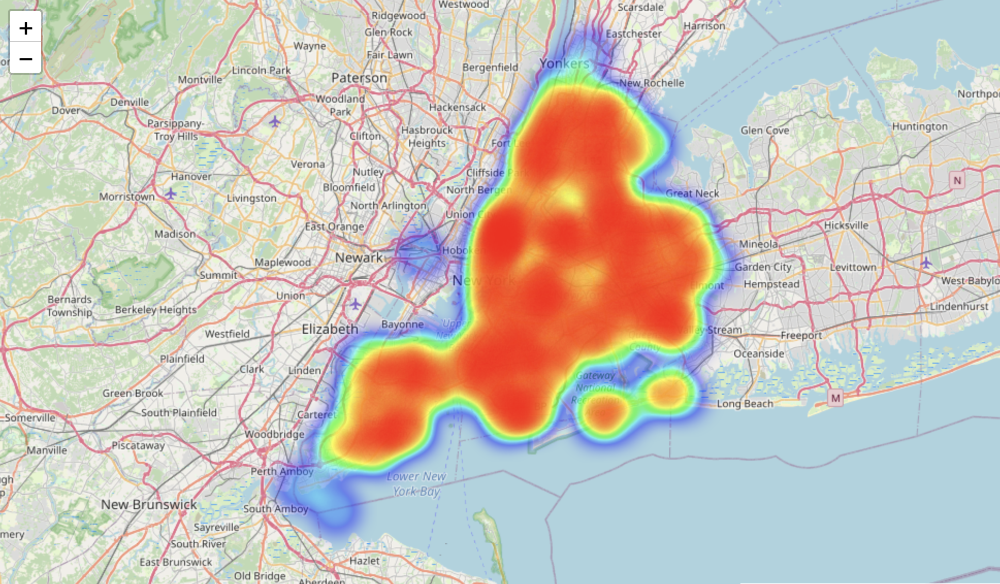

Below is un-normalized heatmap from 1(a)    
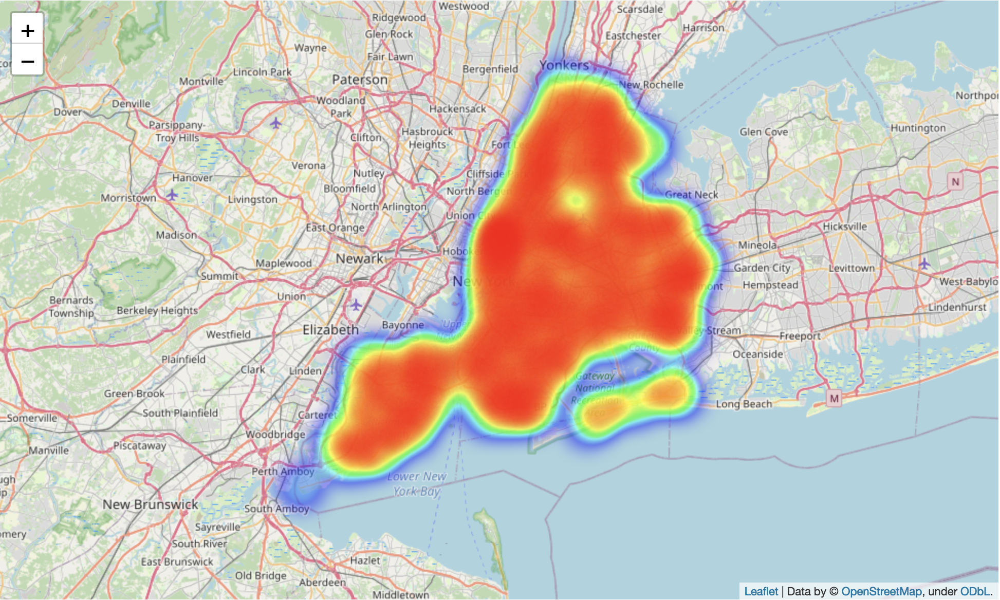




c) Normalize the original price using sklearn's [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html) to the interval [0,1]. Then reproduce the Heatmap from a). Comment on any differences you observe.  - (5 points)



In [ ]:
# Reference https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html
# 


from sklearn.preprocessing import MinMaxScaler
airbnb_1c = pd.read_csv('listings.csv',dtype={'license': object})
#data = [[-1, 2], [-0.5, 6], [0, 10], [1, 18]]




scaler = MinMaxScaler() # sklearn.preprocessing._data.MinMaxScaler
airbnb_series_of_prices=airbnb_1c.loc[:,'price']
print(airbnb_series_of_prices)

airbnb_df_of_prices=airbnb_series_of_prices.to_frame()
# https://pandas.pydata.org/docs/reference/api/pandas.Series.to_frame.html

print(airbnb_df_of_prices)
scaler.fit(airbnb_df_of_prices) # 類似於訓練一個 Model
prices_scaled=scaler.transform(airbnb_df_of_prices) # 類似於用一個 model 做 predict

print(prices_scaled)

airbnb.loc[:,"scaled_price"]=prices_scaled
print(airbnb)



grouped_1c = airbnb.groupby(['latitude','longitude'])
grouped_1c.mean() # pandas.core.frame.DataFrame
series_of_mean_prices=grouped_1c.mean().loc[:,'scaled_price'] # pandas.core.series.Series
print(series_of_mean_prices)


coordinates_1c=series_of_mean_prices.index.tolist()
mean_prices_1c=series_of_mean_prices.values.tolist()
heat_data_1c=[]
for i in range(len(coordinates_1c)):
    heat_data_1c.append([coordinates_1c[i][0],coordinates_1c[i][1],mean_prices_1c[i]])
    

#temp_heat_data=[[40.504559,-74.249840,1],[40.521980 , -74.180370 ,0.8]]
nyc_map_1c = folium.Map([40.693943, -73.985880] , zoom_start=10)
#print(heat_data_1c)
HeatMap(heat_data_1c).add_to(nyc_map_1c)
nyc_map_1c.save("index_1c.html")
nyc_map_1c

-> your answer here


As shown below, the contours of the heatmaps are different. The gradation of scaled heatmap is a little bit more apparent than the un-scaled one. 


Below is scaled from 1(c) 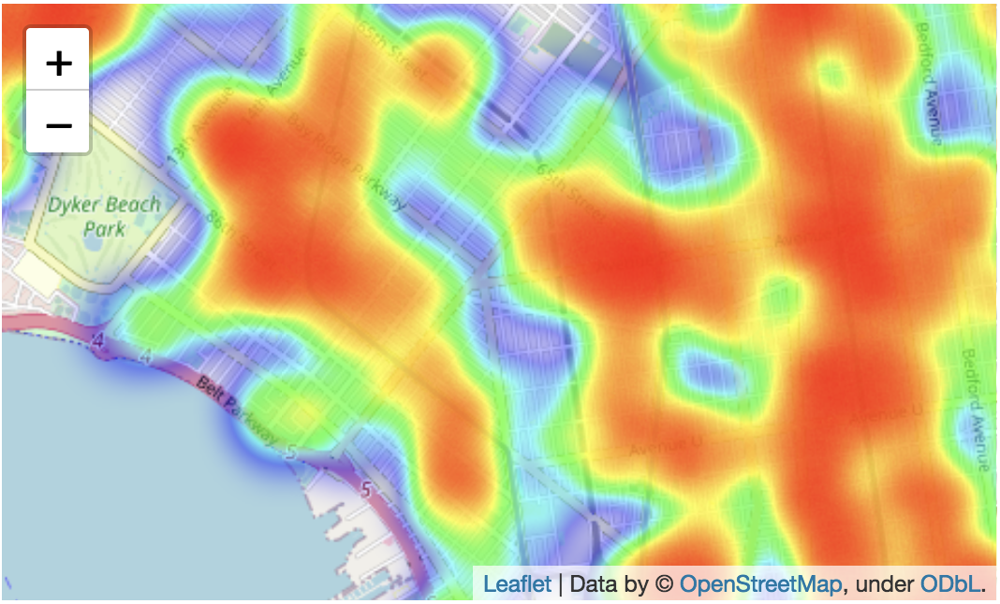

Below is un-scaled from 1(a) 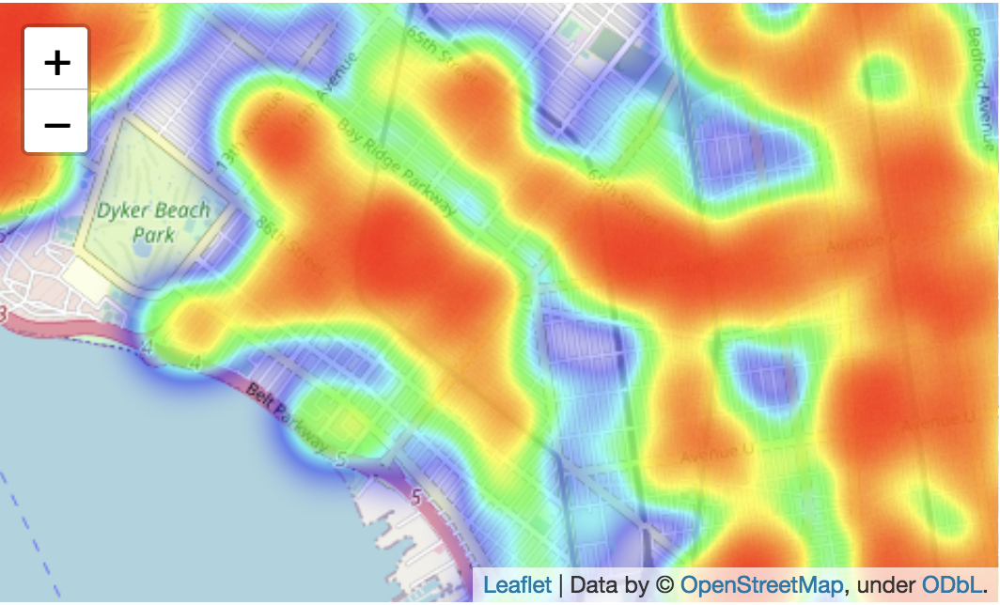






d) Plot a bar chart of the average price (un-normalized) per room type. Briefly comment on the relation between price and room type. - (2.5 points)


In [ ]:
# Reference: 
# https://pandas.pydata.org/docs/reference/api/pandas.Series.plot.bar.html
# 


airbnb_1d = pd.read_csv('listings.csv',dtype={'license': object})
grouped_1d = airbnb.groupby('room_type') #pandas.core.groupby.generic.DataFrameGroupBy
mean_df_1d=grouped_1d.mean()
series_of_mean_prices_1d=mean_df_1d.loc[:,'price']
print(series_of_mean_prices_1d)
series_of_mean_prices_1d.plot.bar()




Averagely, hotel rooms have the highest prices and private rooms have the lowest ones. The prices of entire home/apts and shared rooms are intermediate, but entire home/apts have higher prices than shared rooms.

e) Plot on the NYC map the top 10 most expensive listings - (2.5 points)


https://piazza.com/class/kyj3ikj3q27389?cid=213
>We are supposed to choose 10 unique markers, so expand your selection to select 10 points with different lat/lon values (I think I had to expand my selection to 12 or 13 points to get 10 unique locations). That should take care of your first question as well. 
~ An instructor (Saurav vara prasad chennuri) endorsed this answer  ~




In [ ]:
# Reference: df.groupby(['Mt'], sort=False)['count'].max()
# Reference: https://python-visualization.github.io/folium/quickstart.html


airbnb_1e = pd.read_csv('listings.csv',dtype={'license': object})
grouped_1e=airbnb_1e.groupby(['latitude','longitude'])
series_of_max_prices_1e=grouped_1e['price'].max()

series_of_largest_prices_1e=series_of_max_prices_1e.nlargest(10,keep="all")


nyc_map_1e = folium.Map([40.693943, -73.985880] , zoom_start=10)

coordinates_1e=series_of_largest_prices_1e.index.tolist()
for i in range(len(coordinates_1e)):
    folium.Marker(location=list(coordinates_1e[i])).add_to(nyc_map_1e)
nyc_map_1e.save("index_1e.html")
nyc_map_1e


f) Plot on the NYC map the top 10 most reviewed listings - (2.5 points)

https://piazza.com/class/kyj3ikj3q27389?cid=213
>We are supposed to choose 10 unique markers, so expand your selection to select 10 points with different lat/lon values (I think I had to expand my selection to 12 or 13 points to get 10 unique locations). That should take care of your first question as well. 
~ An instructor (Saurav vara prasad chennuri) endorsed this answer  ~




In [ ]:
airbnb_1f = pd.read_csv('listings.csv',dtype={'license': object})
grouped_1f=airbnb_1f.groupby(['latitude','longitude'])
series_of_max_reviews_1f=grouped_1f['number_of_reviews'].max()

series_of_largest_reviews_1f=series_of_max_reviews_1f.nlargest(10,keep="all")


nyc_map_1f = folium.Map([40.693943, -73.985880] , zoom_start=10)

coordinates_1f=series_of_largest_reviews_1f.index.tolist()
for i in range(len(coordinates_1f)):
    folium.Marker(location=list(coordinates_1f[i])).add_to(nyc_map_1f)
nyc_map_1f.save("index_1f.html")
nyc_map_1f

g) Plot on the NYC map the top 10 most available listings - (2.5 points)

https://piazza.com/class/kyj3ikj3q27389?cid=213
>We are supposed to choose 10 unique markers, so expand your selection to select 10 points with different lat/lon values (I think I had to expand my selection to 12 or 13 points to get 10 unique locations). That should take care of your first question as well. 
~ An instructor (Saurav vara prasad chennuri) endorsed this answer  ~


In [ ]:
airbnb_1g = pd.read_csv('listings.csv',dtype={'license': object})
grouped_1g=airbnb_1g.groupby(['latitude','longitude'])
series_of_max_availability_1g=grouped_1g['availability_365'].max()

series_of_largest_availability_1g=series_of_max_availability_1g.nlargest(10,keep="first")


nyc_map_1g = folium.Map([40.693943, -73.985880] , zoom_start=10)

coordinates_1g=series_of_largest_availability_1g.index.tolist()
for i in range(len(coordinates_1g)):
    folium.Marker(location=list(coordinates_1g[i])).add_to(nyc_map_1g)
nyc_map_1g.save("index_1g.html")
nyc_map_1g

h) Using `longitude`, `latitude`, `price`, and `number_of_reviews`, use Kmeans to create 5 clusters. Plot the points on the NYC map in a color corresponding to their cluster. - (5 points)


In [ ]:
# Reference
#https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html
from sklearn.cluster import KMeans


airbnb_1h = pd.read_csv('listings.csv',dtype={'license': object})
df_of_samples_1h=airbnb_1h.loc[:,['latitude','longitude','price','number_of_reviews']]
df_of_samples_1h

print(df_of_samples_1h.shape[0]) # = len(df_of_samples_1h)

kmeans_1h = KMeans(n_clusters=5).fit(df_of_samples_1h)
kmeans_1h.labels_ # numpy.ndarray

nyc_map_1h = folium.Map([40.693943, -73.985880] , zoom_start=10)

colors_1h=['red', 'blue', 'green', 'purple','orange']


for i in range(len(df_of_samples_1h)):
    folium.Circle(
        location=[df_of_samples_1h.loc[i,'latitude'],list_of_samples_1h.loc[i,'longitude']], # Latitude and Longitude
        radius=5,
        color=colors_1h[kmeans_1h.labels_[i]],
    ).add_to(nyc_map_1h)

nyc_map_1h.save("index_1h.html")

nyc_map_1h


# folium.Marker(location=[40.693943, -73.985880]).add_to(nyc_map_1h)


# m = folium.Map(location=[45.5236, -122.6750], tiles="Stamen Toner", zoom_start=13)

# folium.CircleMarker(
#     location=[45.5215, -122.6261],
#     radius=50,
#     popup="Laurelhurst Park",
#     color="#3186cc",
#     fill=True,
#     fill_color="#3186cc",
# ).add_to(m)

Snapshot of the map above  

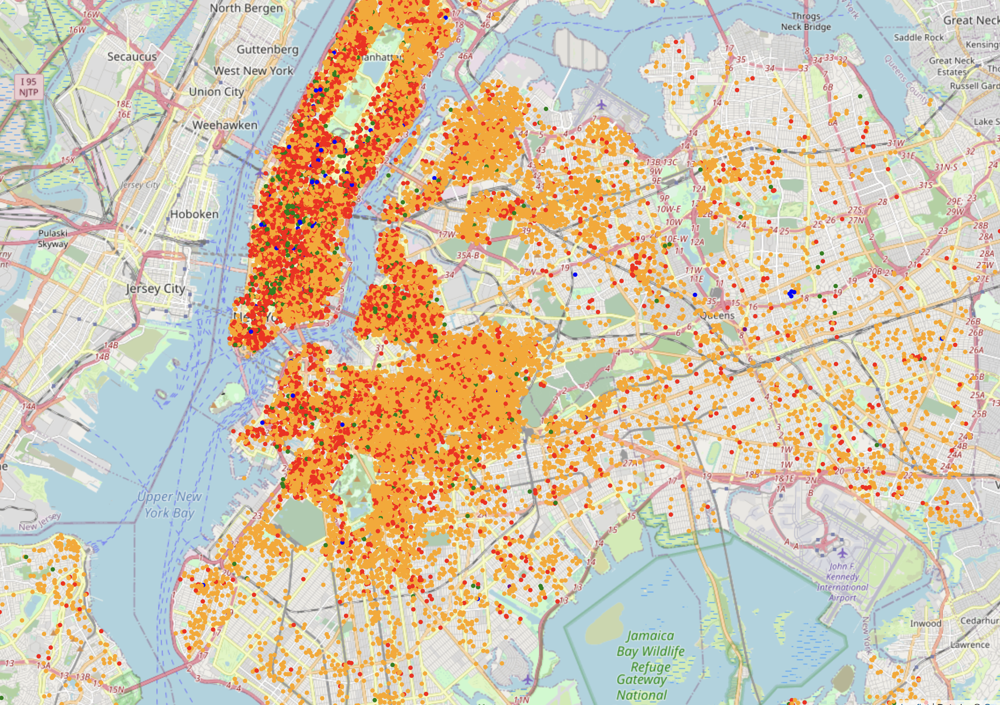

i) You should see points in the same cluster all over the map - briefly explain why that is. - (2.5 points)

-> your answer here

Compared to the dimensions of 'number of reviews' and 'price', the variation of sample points with respect to the dimensions of 'latitude' and 'longitude' is considerably small. Hence the 'latitude' and 'longitude' hardly play a part in determination of distance. Rather, the distance of two sample points almost only depends on the 'number of reviews' and 'price'. So the cluster of points with intermediate 'number of reviews' and 'price' dominates all over the map. 




j) How many clusters would you recommend using instead of 5? Display and interpret either the silhouette scores or the elbow method. - (5 points)

In [ ]:
# Reference: https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html
#kmeans.inertia_ : 
#Sum of squared distances of samples to their closest cluster center, weighted by the sample weights if provided.



from sklearn.cluster import KMeans


airbnb_1j = pd.read_csv('listings.csv',dtype={'license': object})
df_of_samples_1j=airbnb_1h.loc[:,['latitude','longitude','price','number_of_reviews']]
df_of_samples_1j

print(df_of_samples_1j.shape[0]) # = len(df_of_samples_1h)


MIN_K_1j=1
MAX_K_1j=10

costs_1j=pd.Series(index=range(MIN_K_1j, MAX_K_1j+1),dtype="float");
print(costs_1j)
for k_1j in range(MIN_K_1j, MAX_K_1j+1):
    print(k_1j)
    kmeans = KMeans(n_clusters=k_1j).fit(df_of_samples_1j)
    costs_1j.loc[k_1j]=kmeans.inertia_

print(costs_1j)
costs_1j.plot.line()



-> your answer here


Elbow method: draw the graph of costs against increasing k and pick the elbow of the curve as the number of clusters to use. 

As shown in the graph, the elbow of the curve is at k=3, so I would recommend using k=3. 


 

Below is a snapshot of the graph of costs against k.
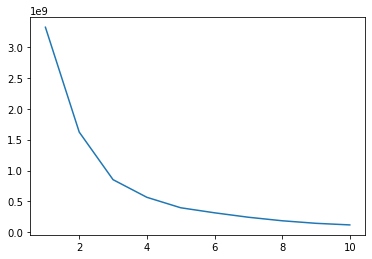 

k) Would you recommend normalizing the price and number of reviews? Briefly explain why. - (2.5 points)

-> your answer here

Yes. I would recommend normalizing the price and number of reviews. That will relatively promote the effect of dimensions of latitude and longitude to the level comparable with dimensions of price and number of reviews. It can avoid the outcome that points of a certain cluster scatter all over the map. 

l) For all listings of type `Shared room`, plot the dendrogram of the hierarchical clustering generated from `longitude`, `latitude`, and `price`. - (5 points)


In [ ]:
# Reference https://docs.scipy.org/doc/scipy/reference/generated/scipy.cluster.hierarchy.dendrogram.html





m) briefly comment on what you observe from the structure of the dendrogram.  - (2.5 points)

-> your answer here

n) Normalize the `price` as in b) and repeat l) - (2.5 points)

## Exercise 2 (50 points)

This exercise will be using the [mnist dataset](http://yann.lecun.com/exdb/mnist/).

a) Using Kmeans, cluster the images using 10 clusters and plot the centroid of each cluster. - (10 points)

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.cluster import KMeans
from sklearn.datasets import load_digits

mnist = load_digits()

# your code here

b) what is the disagreement distance between the clustering you created above and the clustering created by the labels attached to each image? Briefly explain what this number means in this context. - (10 points)

c) Download the CIFAR-10 dataset [here](https://www.cs.toronto.edu/~kriz/cifar.html). Open `batch_1` by following the documentation on the web page. Plot a random image from the dataset. - (10 points)

d) This image is 32 x 32 pixels and each pixel is a 3-dimensional object of RGB (Red, Green, Blue) intensities. Using the same image as in c), produce an image that only uses 4 colors (the 4 centroids of the clusters obtained by clustering the image itself using Kmeans). - (10 points)

e) Write a function that applies this transformation to the entire dataset for any number K of colors. - (10 points)